In [1]:
import sys
sys.path.append("../")

In [2]:
import pandas as pd
import plotly.graph_objects as go
from plotting import CandlePlot
import numpy as np

from simulation.pair_trade_percent_binance import PairTradePercent
from technicals.indicators import Donchian_Close

from functools import reduce

In [3]:

from multiprocessing import Process, Manager
import pickle
import warnings
warnings.filterwarnings('ignore')

In [4]:
from sklearn.linear_model import LinearRegression

def synchronize_dataframes(dfs, df_target, target_name='Target'):
    """
    Sincroniza múltiplos DataFrames pelo timestamp e calcula o índice baseado em regressão multivariada.
    :param dfs: Lista de DataFrames contendo os preços de fechamento dos ativos.
    :param df_target: DataFrame do ativo alvo.
    :param target_name: Nome do ativo alvo (usado no resultado final).
    :return: DataFrame sincronizado com o índice de regressão e o spread.
    """
    # Mesclar todos os DataFrames pelo Timestamp
    df = df_target[['Time', 'Close', 'High', 'Low']].rename(columns={'Close': target_name})
    for i, df_pair in enumerate(dfs):
        df = pd.merge(df, df_pair[['Time', 'Close']].rename(columns={'Close': f'Asset_{i}'}), 
                      on='Time', how='inner')
    return df

import statsmodels.api as sm

# def apply_cointegration(df, target_name):
#     """
#     Aplica cointegração para calcular o índice base.
#     :param df: DataFrame contendo os preços do ativo alvo e do cluster.
#     :param target_name: Nome do ativo alvo.
#     :return: DataFrame com o índice de cointegração e o spread.
#     """
#     # Identificar as colunas dos ativos do cluster
#     asset_columns = [col for col in df.columns if col.startswith('Asset_')]

#     # Ajustar regressão para calcular os coeficientes beta
#     X = df[asset_columns]  # Matriz dos ativos do cluster
#     X = sm.add_constant(X)  # Adicionar intercepto
#     y = df[target_name]  # Preços do ativo alvo
#     model = sm.OLS(y, X).fit()
#     df['Cointegration_Index'] = model.predict(X)

#     # Calcular o spread
#     df['Spread'] = y - df['Cointegration_Index']

#     return df, model.params  # Retorna os coeficientes beta para análise

def apply_cointegration(df, target_name, window=10000):
    """
    Aplica cointegração com uma janela móvel para calcular o índice base.
    :param df: DataFrame contendo os preços do ativo alvo e do cluster.
    :param target_name: Nome do ativo alvo.
    :param window: Tamanho da janela para calcular os coeficientes beta.
    :return: DataFrame com o índice de cointegração e o spread.
    """
    asset_columns = [col for col in df.columns if col.startswith('Asset_')]
    n = len(df)
    indices = []

    for i in range(window, n):
        X = df[asset_columns].iloc[i-window:i]  # Janela dos ativos do cluster
        X = sm.add_constant(X)
        y = df[target_name].iloc[i-window:i]
        model = sm.OLS(y, X).fit()
        beta = model.params.values  # Coeficientes beta
        index_value = np.dot(beta[1:], df[asset_columns].iloc[i].values) + beta[0]  # Previsão
        indices.append(index_value)
    
    # Preencher com NaNs para os primeiros valores
    df['Cointegration_Index'] = [np.nan] * window + indices
    df['Spread'] = df[target_name] - df['Cointegration_Index']
    return df

def fast_apply_cointegration(df, target_name):
    """
    Aplica cointegração usando cálculos vetorizados com NumPy.
    """
    asset_columns = [col for col in df.columns if col.startswith('Asset_')]
    X = np.hstack([np.ones((len(df), 1)), df[asset_columns].values])  # Adicionar intercepto
    y = df[target_name].values.reshape(-1, 1)

    # Solução rápida para regressão (beta = (X.T @ X)^-1 @ X.T @ y)
    beta = np.linalg.inv(X.T @ X) @ X.T @ y
    regression_index = X @ beta
    spread = y - regression_index

    # Adicionar ao DataFrame
    df['Cointegration_Index'] = regression_index.flatten()
    df['Spread'] = spread.flatten()
    return df


from statsmodels.tsa.stattools import adfuller

def test_cointegration(df, spread_column='Spread'):
    """
    Testa a estacionaridade do spread para validar a cointegração.
    :param df: DataFrame contendo o spread.
    :param spread_column: Nome da coluna do spread.
    :return: P-valor do teste de estacionaridade.
    """
    adf_stat, p_value, _, _, _, _ = adfuller(df[spread_column].dropna())
    return p_value  # P-valor menor que 0.05 indica estacionaridade

def fast_adf_test(df, spread_column='Spread'):
    """
    Realiza o teste ADF rápido, retornando apenas o p-valor.
    """
    _, p_value, _, _, _, _ = adfuller(df[spread_column].dropna(), autolag='AIC')
    return p_value
    

def calculate_zscore(df, spread_column='Spread', window=50):
    """
    Calcula o Z-Score do spread usando uma janela móvel.
    :param df: DataFrame com a coluna 'Spread'.
    :param spread_column: Nome da coluna de spread.
    :param window: Tamanho da janela para calcular a média e o desvio padrão.
    :return: DataFrame atualizado com a coluna 'Z-Score'.
    """
    df['Spread_Mean'] = df[spread_column].rolling(window=window).mean()
    df['Spread_Std'] = df[spread_column].rolling(window=window).std()
    df['Z-Score'] = (df[spread_column] - df['Spread_Mean']) / df['Spread_Std']
    return df


In [5]:

cluster_assets = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
          'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']


In [6]:
target_asset = 'INJUSDT'
granularity = '1m'

In [7]:
# Carregar os DataFrames de ativos
df_target = pd.read_pickle(f"crypto/{target_asset}_{granularity}.pkl")
dfs_cluster = [
    pd.read_pickle(f"crypto/{asset}_{granularity}.pkl") for asset in cluster_assets
]


# Sincronizar e calcular o índice PCA e o spread
df = synchronize_dataframes(dfs_cluster, df_target, target_name=target_asset)




In [8]:

df = fast_apply_cointegration(df, target_asset)


# Calcular o spread com o ativo alvo
df['Spread'] = df[target_asset] - df['Cointegration_Index']



In [9]:
# Calcular o Z-Score do spread
df = calculate_zscore(df, spread_column='Spread', window=200)

df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)

In [10]:
df[['Time',target_asset,'Cointegration_Index', 'Spread', 'Spread_Mean', 'Spread_Std','Z-Score']].tail()

,Time,INJUSDT,Cointegration_Index,Spread,Spread_Mean,Spread_Std,Z-Score
919876,2024-09-30 23:55:00,22.89,21.916015,0.973985,1.415658,0.233924,-1.888105
919877,2024-09-30 23:56:00,22.90,21.929707,0.970293,1.412611,0.235738,-1.876311
919878,2024-09-30 23:57:00,22.91,21.935164,0.974836,1.409586,0.237457,-1.830857
919879,2024-09-30 23:58:00,22.89,21.946559,0.943441,1.406337,0.239370,-1.933815
919880,2024-09-30 23:59:00,22.89,21.914486,0.975514,1.403219,0.240903,-1.775429


In [11]:
def run_pair(granularity,
             lenght=10000,
             strategy=1,
             target_asset='VIDTUSDT',
             cluster_asset=['AVAXUSDT','BNBUSDT','LTCUSDT'],
             entry_threshold=3,
             exit_threshold=0,
             window=50
            ):

    # Carregar os DataFrames de ativos
    df_target = pd.read_pickle(f"crypto/{target_asset}_{granularity}.pkl")
    dfs_cluster = [
        pd.read_pickle(f"crypto/{asset}_{granularity}.pkl") for asset in cluster_asset
    ]
    

    # Sincronizar os DataFrames
    df = synchronize_dataframes(dfs_cluster, df_target, target_name=target_asset)
    
    # Aplicar cointegração para calcular o índice base e o spread
    df = fast_apply_cointegration(df, target_name=target_asset)
    
    # Testar estacionaridade do spread
    # p_value = fast_adf_test(df, spread_column='Spread')
    # if p_value < 0.05:
    #     print(f"Spread estacionário (p-valor = {p_value:.4f}). Coeficientes beta: {beta_coefficients}")
    # else:
    #     print(f"Spread não estacionário (p-valor = {p_value:.4f}).")
    
    # Calcular o Z-Score do spread
    df = calculate_zscore(df, spread_column='Spread', window=50)
    
    df['Close_Pair1'] = df[target_asset]
    
    df.dropna(inplace=True)
    df.reset_index(drop=True, inplace=True)

    corr = 0
    spread_vol = 0


    df['time'] = df['Time'].copy()
    df['strategy_pair1'] = 0
    # dff['returns'] = dff['Close'].pct_change()
    df['returns_pair1'] = np.log(df['Close_Pair1'] / df['Close_Pair1'].shift(1))
    df['creturns_pair1'] = df['returns_pair1'].cumsum()
    df['Log_Returns_pair1'] = np.log(df['Close_Pair1'] / df['Close_Pair1'].shift(1))
    df['cLog_Returns_pair1'] = df['Log_Returns_pair1'].cumsum()

    # df = df.iloc[lenght:]
    df = df[df['Time'] >= lenght]
    
    df.dropna(inplace=True)
    
    df.reset_index(drop=True, inplace=True)


    

    
    gt = PairTradePercent(
        df,
        strategy,
        entry_threshold,
        exit_threshold,
        corr,
        spread_vol
    )
    
    gt.run_test()
    return gt
    

In [32]:
target_assets = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
          'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']
cluster_assets = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
          'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']


# pairs1 = ['BELUSDT']
# pairs2 = ['DOTUSDT']

In [33]:
# df.columns

In [34]:
def get_list_args():
    args_dic_list = []
    for target_asset in target_assets:
        for cluster_asset in [cluster_assets]:
            cluster_asset__ = []
            for i in cluster_asset:
                if i != target_asset:
                    cluster_asset__.append(i)
            for granularity in ['1m']:
                for lenght in ['2023-01-01 00:00:00']:
                    for strategy in [1]:
                        for entry_threshold in [2,3,4,5,6]:
                            for exit_threshold in [0]:
                                for window in [200]:
                                
                                    args_dic = {
                                        "granularity":granularity,
                                        'lenght': lenght,
                                        'strategy':strategy,
                                        'target_asset': target_asset,
                                        'cluster_asset':cluster_asset__,
                                        'entry_threshold':entry_threshold,
                                        'exit_threshold':exit_threshold,
                                        'window':window
                                    }
                                    args_dic_list.append(args_dic)

    return args_dic_list

In [35]:

def run_process(L, arg):
    # print("PROCESS",arg)
    L.append(
        dict(
            arg=arg,
            target_asset=arg['target_asset'],
            cluster_asset=arg['cluster_asset'],
            granularity=arg['granularity'],
            lenght = arg['lenght'],
            strategy = arg['strategy'],
            entry_threshold = arg['entry_threshold'],
            exit_threshold = arg['exit_threshold'],
            window = arg['window'],
            res=run_pair(
                granularity=arg['granularity'],
                lenght = arg['lenght'],
                strategy= arg['strategy'],
                target_asset=arg['target_asset'],
                cluster_asset=arg['cluster_asset'],
                entry_threshold = arg['entry_threshold'],
                exit_threshold = arg['exit_threshold'],
                window = arg['window']
            )
        )
    )


lista = []
def run_ema_macd():
    with Manager() as manager:
        global lista
        L = manager.list()  # <-- can be shared between processes.
        args_list = get_list_args()
        print(len(args_list))
        limit = 10
        current = 0
    
        while current < len(args_list):
            print(current)
            processes = []
            todo = len(args_list) - current
            if todo < limit:
                limit = todo
    
            for _ in range(limit):
                processes.append(Process(target=run_process, args=(L,args_list[current])))
                current += 1
    
            for p in processes:
                p.start()
    
            for p in processes:
                p.join()

        print("ALL DONE")
        lista = list(L)
        

In [36]:
%%time

run_ema_macd()

150
0
10
20
30
40
50
60
70
80
90
100
110
120
130
140
ALL DONE
CPU times: user 363 ms, sys: 16.2 s, total: 16.5 s
Wall time: 14min 40s


In [37]:
# ddf = lista[0]['res'].df.copy()

In [38]:
# with open(f"./result-pair-trading-new-data-strategy-1-CPA-with-sl-0.05-1min-2023-to-end.pkl", "wb") as f:
#     pickle.dump(lista, f)  # Usa o pickle para salvar o arquivo



In [39]:
# listaa = []

# # Carregar os arquivos e expandir seus conteúdos diretamente na lista principal
# for filename in [
#     "./result-binance-acumulative-percentual-strategy-1-2-3-4-5.pkl",
#     "./result-binance-acumulative-percentual-strategy-6-7-8-9.pkl",
#     "./result-binance-acumulative-percentual-strategy-10-11-12.pkl"
# ]:
#     with open(filename, "rb") as f:
#         listaa.extend(pickle.load(f))
        
# with open(f"./result-binance-acumulative-percentual-strategy-1-12.pkl", "wb") as f:
#     pickle.dump(listaa, f)  # Usa o pickle para salvar o arquivo



In [40]:
# cp = CandlePlot(ddf.iloc[-50000:],candles=False)


# trades_up = cp.df_plot[cp.df_plot.SIGNAL_UP_PAIR1 == 1]

# trades_down = cp.df_plot[cp.df_plot.SIGNAL_DOWN_PAIR1 == 1]

# print(len(trades_up),len(trades_down))

In [41]:

# marker_trade_up = '#abebc6'
# marker_trade_down = '#cccddd'


# markers = 'Close_Pair1'


# cp.add_traces(['Close_Pair1'])


# # # SIGNAL UP
# cp.fig.add_trace(go.Scatter(
#     x = trades_up.sTime,
#     y = trades_up[markers],
#     mode = 'markers',
#     marker_symbol = 'triangle-up',
#     marker=dict(color=marker_trade_up, size=12)
# ))

# cp.fig.add_trace(go.Scatter(
#     x = trades_down.sTime,
#     y = trades_down[markers],
#     mode = 'markers',
#     marker_symbol = 'triangle-down',
#     marker=dict(color=marker_trade_down, size=12)
# ))


# cp.show_plot(height=700, width=1100, sec_traces=['PCA_Index'])

In [45]:
res = lista

# with open(f"./result-binance-acumulative-percentual-new-data-strategy-14-1min-2024-split_profit.pkl", "rb") as f:
#     res = pickle.load(f)

In [46]:

dic_res = []
for r in res:

    if r['res'].len_close > 0:
        signal_up = r['res'].df_results.SIGNAL_UP.values[-1]

        res_pos_s = r['res'].df_results[r['res'].df_results['strategy_pair1'] > 0]
        res_neg_s = r['res'].df_results[r['res'].df_results['strategy_pair1'] <= 0]
        sum_neg_s = res_neg_s.strategy_pair1.sum() *-1
        sum_pos_s = res_pos_s.strategy_pair1.sum()
        dic_res.append(
            dict(
                pair1 = r['target_asset'],
                granularity = r['granularity'],
                strat = round(r['res'].df_results.strategy_pair1.sum(),3),
                c = r['res'].df_results['count'].mean(),
                max_o = max(r['res'].df_results.total_opened),
                st = r['res'].strategy,
                entry_threshold = r['entry_threshold'],
                window = r['window'],
                
                corr = r['res'].corr,
                spread_vol = r['res'].spread_vol,
                s_p_strat = sum_pos_s,
                s_n_strat = sum_neg_s,
                Rel_sum = sum_pos_s/(sum_pos_s+ sum_neg_s),
        
                
                l_p_strat = len(res_pos_s),
                l_n_strat = len(res_neg_s),
                Rel_len = len(res_pos_s)/(len(res_pos_s)+ len(res_neg_s)),

                l_c = r['res'].len_close,
                l_o = r['res'].len_open,
                   

                first_p = r['res'].first_price,
                last_p = r['res'].last_price,

                first_t = r['res'].df_results.start_time.values[0],
                last_t = r['res'].df_results.end_time.values[-1],
                
                r = r['res'].df_results,
                # df = r['res'].df
            )
    )
    # print(f"p={p}  e={e}  dw={dw}  dwp={dwp}   strategy={st}   result={result}")


In [47]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [48]:
df_res = pd.DataFrame(dic_res)

In [49]:
df_sorted_desc = df_res.sort_values(by=['pair1','strat'], ascending=False)

In [50]:
df_sorted_desc.columns

Index(['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'window', 'corr', 'spread_vol', 's_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'first_p', 'last_p',
       'first_t', 'last_t', 'r'],
      dtype='object')

In [51]:
# Exibir todas as linhas
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

df_sorted_desc[['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'window', 'corr', 'spread_vol', 's_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,granularity,strat,c,max_o,st,entry_threshold,window,corr,spread_vol,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
16,XRPUSDT,1m,-0.031,27.050000,1,1,6,200,0,0,0.029722,0.060288,0.330209,5,15,0.250000,20,0
17,XRPUSDT,1m,-0.109,17.000000,1,1,5,200,0,0,0.158880,0.267839,0.372329,31,62,0.333333,93,0
19,XRPUSDT,1m,-0.323,38.465839,2,1,4,200,0,0,0.907683,1.230871,0.424438,221,262,0.457557,483,1
18,XRPUSDT,1m,-3.000,34.940524,3,1,3,200,0,0,6.190617,9.190211,0.402489,2229,2546,0.466806,4775,1
15,XRPUSDT,1m,-12.841,25.841774,4,1,2,200,0,0,18.092601,30.933605,0.369039,8226,10829,0.431698,19055,0
29,XLMUSDT,1m,2.102,25.444513,4,1,2,200,0,0,25.109497,23.007920,0.521838,12056,7354,0.621123,19410,0
27,XLMUSDT,1m,1.429,34.200397,2,1,3,200,0,0,7.760802,6.332151,0.550687,2740,1796,0.604056,4536,0
25,XLMUSDT,1m,0.693,32.437500,2,1,4,200,0,0,1.432722,0.739979,0.659420,234,166,0.585000,400,0
26,XLMUSDT,1m,0.635,36.797297,2,1,5,200,0,0,0.773546,0.138932,0.847742,43,31,0.581081,74,0
28,XLMUSDT,1m,0.477,32.000000,1,1,6,200,0,0,0.523032,0.045712,0.919627,7,10,0.411765,17,0


In [26]:
# df_sorted_desc.iloc[4].r['time'] = df_sorted_desc.iloc[4].r['end_time']
# df_sorted_desc.iloc[4].r['GAIN_C'] = df_sorted_desc.iloc[4].r.strategy.cumsum()

# cp = CandlePlot(df_sorted_desc.iloc[4].r, candles=False)
# cp.show_plot(line_traces = ['GAIN_C'])

In [52]:
def rank_backtest_results(df):
    # Definindo pesos para cada coluna com base na importância
    weights = {
        'strat': 0.4,           # Retorno acumulado percentual (maximizar)
        'Rel_sum': 0.2,        # Relação de resultados positivos/negativos (maximizar)
    }
    
    # Normalizando as colunas relevantes
    for col in weights.keys():
        df[col + '_norm'] = (df[col] - df[col].min()) / (df[col].max() - df[col].min())
    
    # Calculando o score ponderado para cada linha
    df['score'] = sum(
        df[col + '_norm'] * weight if weight >= 0 else (1 - df[col + '_norm']) * abs(weight) 
        for col, weight in weights.items()
    )
    
    # Ordenando o DataFrame pelos melhores resultados com base no score
    df_sorted = df.sort_values(by='score', ascending=False).reset_index(drop=True)
    
    # Removendo colunas de normalização temporárias
    df_sorted.drop(columns=[col + '_norm' for col in weights.keys()], inplace=True)
    
    return df_sorted

In [53]:
pairs = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
          'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']

In [54]:
# df_APTUSDT = df_res[df_res['pair']=='APTUSDT']
# df_DOTUSDT = df_res[df_res['pair']=='DOTUSDT']
# df_DOGEUSDT = df_res[df_res['pair']=='DOGEUSDT']
# df_ADAUSDT = df_res[df_res['pair']=='ADAUSDT']
# df_XRPUSDT = df_res[df_res['pair']=='XRPUSDT']
# df_VIDTUSDT = df_res[df_res['pair']=='VIDTUSDT']
# df_TRXUSDT = df_res[df_res['pair']=='TRXUSDT']
# df_XLMUSDT = df_res[df_res['pair']=='XLMUSDT']

In [55]:
# rank_APT = rank_backtest_results(df_APTUSDT)
# rank_DOT = rank_backtest_results(df_DOTUSDT)
# rank_DOGE = rank_backtest_results(df_DOGEUSDT)
# rank_ADA = rank_backtest_results(df_ADAUSDT)
# rank_XRP = rank_backtest_results(df_XRPUSDT)
# rank_VIDT = rank_backtest_results(df_VIDTUSDT)
# rank_TRX = rank_backtest_results(df_TRXUSDT)
# rank_XLM = rank_backtest_results(df_XLMUSDT)



In [56]:
# Lista de pares
pairs = ['DOTUSDT','DOGEUSDT','ADAUSDT','XRPUSDT','TRXUSDT','XLMUSDT','APTUSDT','VIDTUSDT','BTCUSDT',
         'ETHUSDT','AVAXUSDT','BNBUSDT','LTCUSDT','LINKUSDT',
         'BCHUSDT','EOSUSDT','ETCUSDT','DASHUSDT','ALGOUSDT','SANDUSDT',
         'ARUSDT', 'INJUSDT', 'MASKUSDT', 'CELOUSDT', 'BANDUSDT', 'ALPHAUSDT', 'PERPUSDT',
         'ACHUSDT', 'CHRUSDT', 'BELUSDT']

# Dicionários para armazenar DataFrames e ranks
df_dict = {}
rank_dict = {}

# Loop para criar DataFrames e calcular ranks
for pair in pairs:
    df_dict[pair] = df_res[df_res['pair1'] == pair]
    rank_dict[pair] = rank_backtest_results(df_dict[pair])



In [57]:
# Exemplo de como acessar os resultados
df_dict['DOTUSDT'].columns  # DataFrame do par DOTUSDT


Index(['pair1', 'granularity', 'strat', 'c', 'max_o', 'st', 'entry_threshold',
       'window', 'corr', 'spread_vol', 's_p_strat', 's_n_strat', 'Rel_sum',
       'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o', 'first_p', 'last_p',
       'first_t', 'last_t', 'r', 'strat_norm', 'Rel_sum_norm', 'score'],
      dtype='object')

In [58]:
mean_dict = []
for pair in pairs:
    dic_ = {
        "pair": pair,
        "strat": round(rank_dict[pair].strat.mean(),2),
        "rel_sum": round(rank_dict[pair].Rel_sum.mean(),2)
    }
    mean_dict.append(dic_)
    
df_mean = pd.DataFrame(mean_dict)

df_mean = df_mean.sort_values(by='strat', ascending=False).reset_index(drop=True)
df_mean

,pair,strat,rel_sum
0,VIDTUSDT,3.77,0.66
1,CELOUSDT,1.78,0.51
2,ALPHAUSDT,1.56,0.65
3,EOSUSDT,1.25,0.56
4,XLMUSDT,1.07,0.70
5,BANDUSDT,-0.40,0.52
6,ALGOUSDT,-0.63,0.59
7,DASHUSDT,-1.03,0.58
8,PERPUSDT,-1.05,0.48
9,ACHUSDT,-1.34,0.49


In [60]:
rank_dict['VIDTUSDT'] = rank_dict['VIDTUSDT'].round(2)
rank_dict['VIDTUSDT'].head(350)[['pair1', 'strat', 'c', 'max_o',
       'entry_threshold','window', 'corr', 'spread_vol', 's_p_strat', 's_n_strat',
       'Rel_sum', 'l_p_strat', 'l_n_strat', 'Rel_len', 'l_c', 'l_o']]

,pair1,strat,c,max_o,entry_threshold,window,corr,spread_vol,s_p_strat,s_n_strat,Rel_sum,l_p_strat,l_n_strat,Rel_len,l_c,l_o
0,VIDTUSDT,12.48,29.24,4,2,200,0,0,43.93,31.45,0.58,11678,6782,0.63,18460,0
1,VIDTUSDT,0.19,55.42,1,6,200,0,0,0.21,0.03,0.88,14,12,0.54,26,0
2,VIDTUSDT,4.70,39.99,3,3,200,0,0,14.97,10.27,0.59,3219,1878,0.63,5097,1
3,VIDTUSDT,1.22,84.98,3,4,200,0,0,2.96,1.74,0.63,436,291,0.60,727,1
4,VIDTUSDT,0.24,32.63,1,5,200,0,0,0.58,0.33,0.63,75,55,0.58,130,0


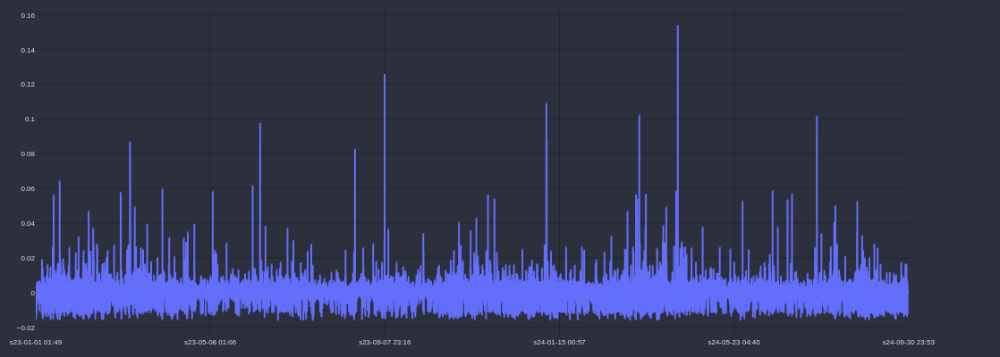

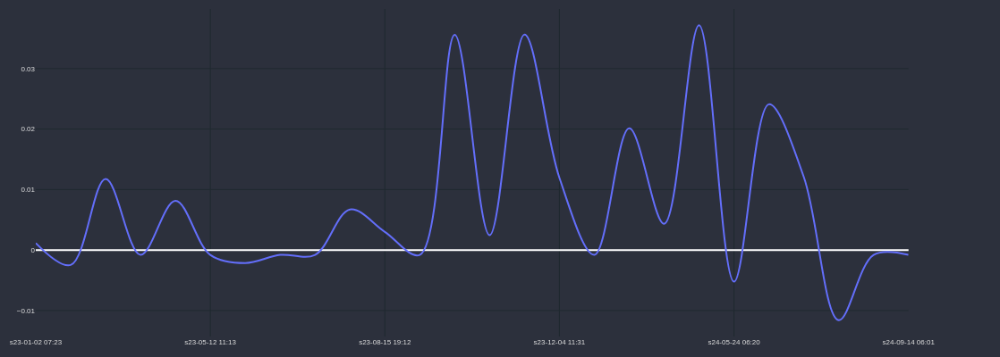

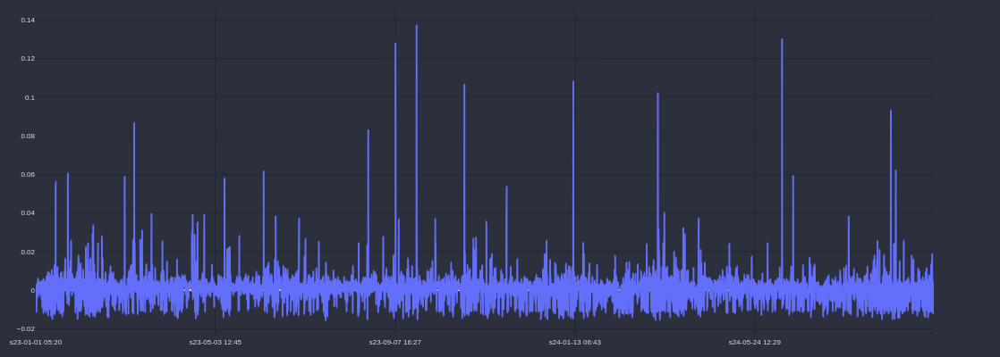

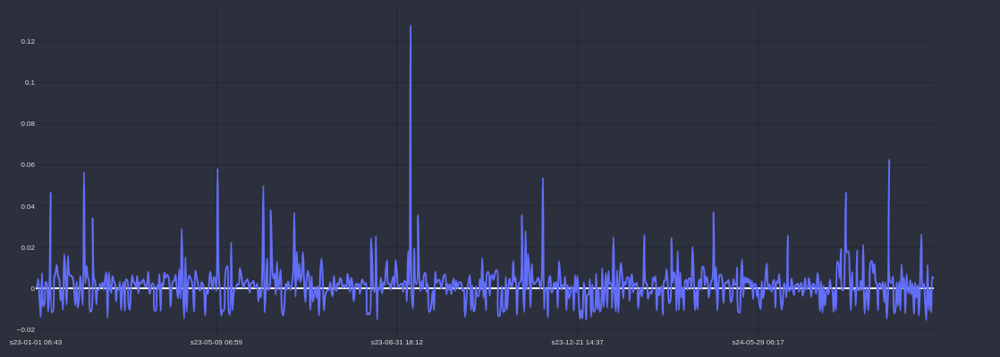

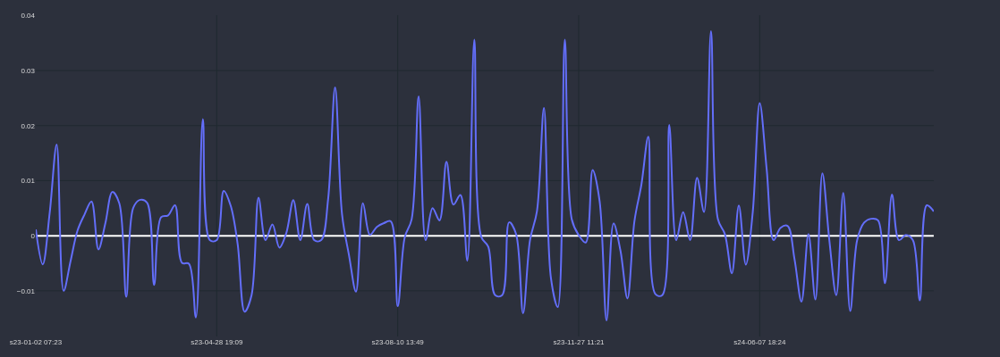

In [61]:
for index in range(len(rank_dict['VIDTUSDT'])):
    rank = rank_dict['VIDTUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_I'] = rank.r.strategy_pair1

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_I'])

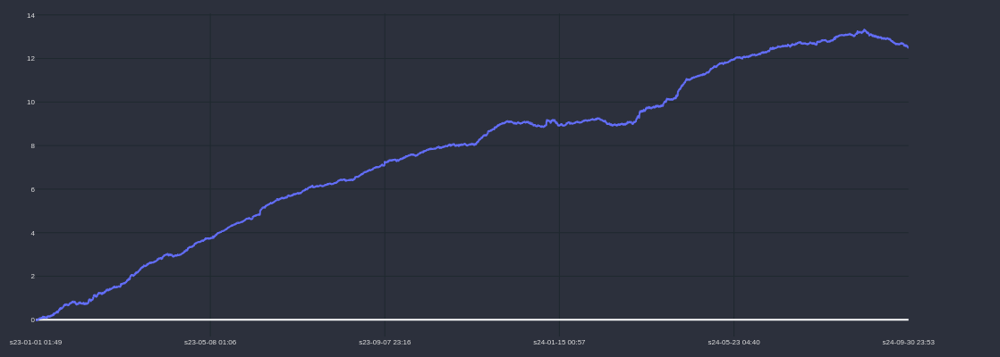

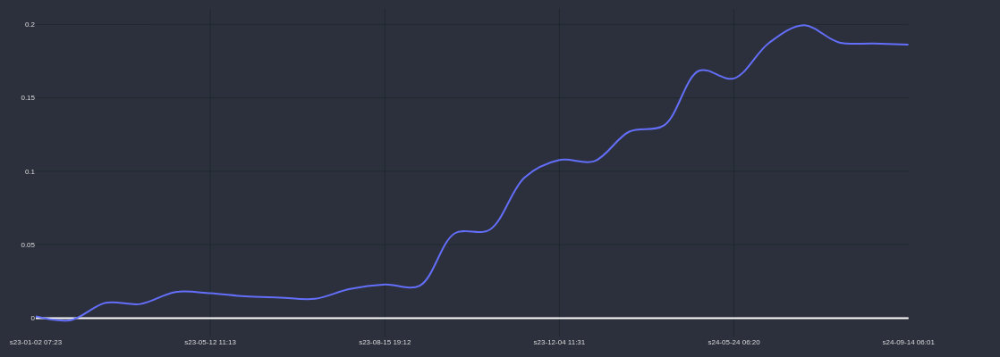

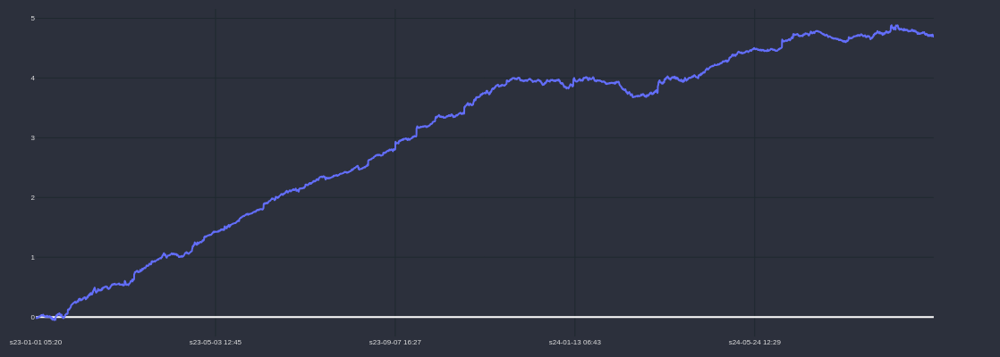

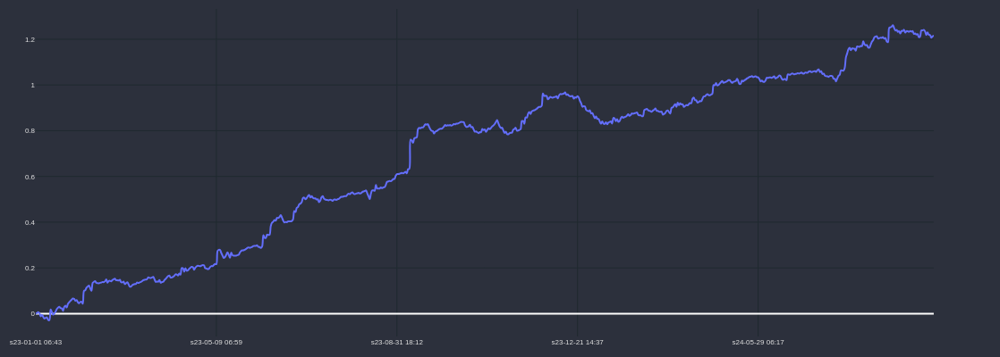

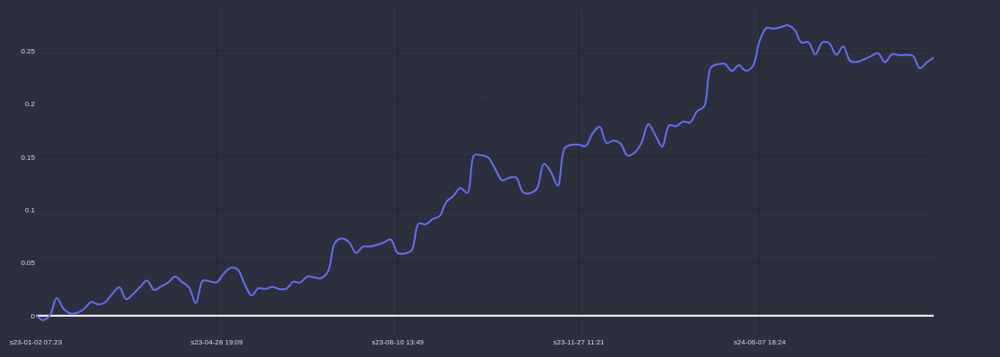

In [63]:
for index in range(len(rank_dict['VIDTUSDT'])):
    rank = rank_dict['VIDTUSDT'].iloc[index]
    rank.r['time'] = rank.r['end_time']
    rank.r['GAIN_C'] = rank.r.strategy_pair1.cumsum()

    cp = CandlePlot(rank.r, candles=False)
    cp.show_plot(line_traces = ['GAIN_C'])

In [64]:
def calcular_operacoes_simultaneas(df):
    # Ordena o DataFrame por start_time para facilitar o cálculo
    df = df.sort_values(by='start_time').reset_index(drop=True)
    # Inicializa a coluna operacoes_simultaneas com o valor mínimo de 0
    df['operacoes_simultaneas'] = 0
    
    # Itera sobre cada operação e conta quantas estão abertas e não fechadas no momento
    for i, row in df.iterrows():
        # Conta quantas operações estão em andamento no tempo de start_time da operação atual
        count = ((df['start_time'] <= row['start_time']) & (df['end_time'] > row['start_time'])).sum()
        # Atualiza a coluna com o número de operações simultâneas, garantindo o mínimo de 1
        df.at[i, 'operacoes_simultaneas'] = max(count, 1)
        
    return df

In [91]:

# Concatenar os DataFrames filtrados, acessando os 10 primeiros elementos do atributo `r` de cada um
concat_ranks = pd.concat(
    [
        rank_dict['XLMUSDT'].iloc[index].r for index in range(len(rank_dict['XLMUSDT']))
    ]
)


In [92]:
concat_ranks.shape

(24437, 19)

In [93]:
concat_ranks.strategy_pair1.sum()

np.float64(5.334905417668952)

In [94]:
df_test = calcular_operacoes_simultaneas(concat_ranks)
df_test.operacoes_simultaneas.max()

np.int64(8)

In [95]:
df_test.tail()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,operacoes_simultaneas
24432,False,919893,35,0,0.001202,0.002002,1,False,0,0.005,-0.01,sell,0.1000,0.0998,0,1,0.0002,2024-09-30 22:41:00,2024-09-30 22:07:00,1
24433,False,919898,30,0,0.001202,0.002002,1,False,0,0.005,-0.01,sell,0.1000,0.0998,0,1,0.0002,2024-09-30 22:41:00,2024-09-30 22:12:00,2
24434,False,919979,14,0,0.001228,0.002028,1,False,0,0.005,-0.01,sell,0.0987,0.0985,0,1,0.0002,2024-09-30 23:46:00,2024-09-30 23:33:00,3
24435,False,919979,14,0,0.001228,0.002028,1,False,0,0.005,-0.01,sell,0.0987,0.0985,0,1,0.0002,2024-09-30 23:46:00,2024-09-30 23:33:00,3
24436,False,919979,14,0,0.001228,0.002028,1,False,0,0.005,-0.01,sell,0.0987,0.0985,0,1,0.0002,2024-09-30 23:46:00,2024-09-30 23:33:00,3


In [96]:
concat_ranks.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy_pair1',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'trailing_stop_target', 'trailing_stop_loss', 'type', 'start_price',
       'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN', 'result', 'end_time',
       'start_time'],
      dtype='object')

In [97]:
df_test.strategy_pair1.sum()

np.float64(5.334905417668952)

In [98]:
(5000/df_test.operacoes_simultaneas.max()) * df_test.strategy_pair1.sum()

np.float64(3334.315886043095)

In [99]:
df_test.tail()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,operacoes_simultaneas
24432,False,919893,35,0,0.001202,0.002002,1,False,0,0.005,-0.01,sell,0.1000,0.0998,0,1,0.0002,2024-09-30 22:41:00,2024-09-30 22:07:00,1
24433,False,919898,30,0,0.001202,0.002002,1,False,0,0.005,-0.01,sell,0.1000,0.0998,0,1,0.0002,2024-09-30 22:41:00,2024-09-30 22:12:00,2
24434,False,919979,14,0,0.001228,0.002028,1,False,0,0.005,-0.01,sell,0.0987,0.0985,0,1,0.0002,2024-09-30 23:46:00,2024-09-30 23:33:00,3
24435,False,919979,14,0,0.001228,0.002028,1,False,0,0.005,-0.01,sell,0.0987,0.0985,0,1,0.0002,2024-09-30 23:46:00,2024-09-30 23:33:00,3
24436,False,919979,14,0,0.001228,0.002028,1,False,0,0.005,-0.01,sell,0.0987,0.0985,0,1,0.0002,2024-09-30 23:46:00,2024-09-30 23:33:00,3


In [100]:
df_test.describe()

,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,operacoes_simultaneas
count,24437.000000,24437.000000,24437.0,24437.000000,24437.000000,24437.000000,24437.000000,24437.000000,24437.000000,24437.000000,24437.000000,24437.000000,24437.000000,24437.000000,24437,24437,24437.000000
mean,458417.695094,27.223186,0.0,0.000218,0.000982,1.043622,0.110979,0.006317,-0.008113,0.107254,0.107271,0.499529,0.500471,0.000103,2023-11-15 11:04:16.443098624,2023-11-15 10:38:02.796578816,1.362238
min,10.000000,1.000000,0.0,-0.015791,-0.100680,1.000000,0.000000,0.005000,-0.010000,0.070700,0.070800,0.000000,0.000000,-0.018600,2023-01-01 01:09:00,2023-01-01 01:00:00,1.000000
25%,224518.000000,10.000000,0.0,-0.001504,-0.000713,1.000000,0.000000,0.005000,-0.010000,0.092400,0.092400,0.000000,0.000000,-0.000100,2023-06-06 00:55:00,2023-06-06 00:32:00,1.000000
50%,456131.000000,20.000000,0.0,0.000301,0.001098,1.000000,0.000000,0.005000,-0.010000,0.106200,0.106200,0.000000,1.000000,0.000100,2023-11-13 20:51:00,2023-11-13 20:45:00,1.000000
75%,691478.000000,35.000000,0.0,0.001974,0.002759,1.000000,0.000000,0.005000,-0.010000,0.119100,0.119100,1.000000,1.000000,0.000300,2024-04-25 07:44:00,2024-04-25 07:12:00,2.000000
max,919979.000000,7650.000000,0.0,0.459591,0.460391,4.000000,1.000000,1.280000,0.455947,0.194200,0.194200,1.000000,1.000000,0.057300,2024-09-30 23:46:00,2024-09-30 23:33:00,8.000000
std,266599.006721,69.492910,0.0,0.007842,0.007918,0.208619,0.314113,0.019255,0.008638,0.017760,0.017783,0.500010,0.500010,0.000967,NaN,NaN,0.648211


In [101]:
df_test = df_test.sort_values(by='end_time', ascending=True).reset_index(drop=True)
df_test.head()

,running,start_index_m5,count,trigger_type,strategy_pair1,strategy_no_tc,total_opened,first_return,trail_stop_trigger,trailing_stop_target,trailing_stop_loss,type,start_price,trigger_price,SIGNAL_UP,SIGNAL_DOWN,result,end_time,start_time,operacoes_simultaneas
0,False,10,10,0,0.000613,1.413428e-03,1,False,0,0.005,-0.01,buy,0.0707,0.0708,1,0,0.0001,2023-01-01 01:09:00,2023-01-01 01:00:00,1
1,False,25,26,0,-0.000800,2.870967e-16,1,False,0,0.005,-0.01,sell,0.0710,0.0710,0,1,0.0000,2023-01-01 01:40:00,2023-01-01 01:15:00,1
2,False,84,4,0,0.002013,2.812941e-03,1,False,0,0.005,-0.01,sell,0.0712,0.0710,0,1,0.0002,2023-01-01 02:17:00,2023-01-01 02:14:00,1
3,False,94,17,0,0.000607,1.407460e-03,1,False,0,0.005,-0.01,sell,0.0711,0.0710,0,1,0.0001,2023-01-01 02:40:00,2023-01-01 02:24:00,1
4,False,164,5,0,0.000609,1.409444e-03,1,False,0,0.005,-0.01,sell,0.0710,0.0709,0,1,0.0001,2023-01-01 03:38:00,2023-01-01 03:34:00,1


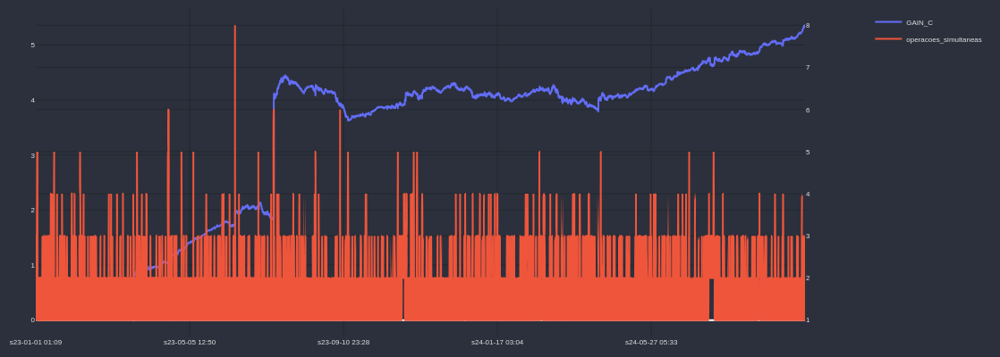

In [102]:

df_test['time'] = df_test['end_time']
df_test['GAIN_C'] = df_test.strategy_pair1.cumsum()

cp = CandlePlot(df_test, candles=False)
cp.show_plot(line_traces = ['GAIN_C'], sec_traces=['operacoes_simultaneas'])

In [103]:
pos = df_test[df_test['strategy_pair1']>0]
neg = df_test[df_test['strategy_pair1']<0]

print(len(pos),len(neg), len(pos)/(len(pos)+len(neg)))

15080 9357 0.6170970250030691


In [104]:
df_test.columns

Index(['running', 'start_index_m5', 'count', 'trigger_type', 'strategy_pair1',
       'strategy_no_tc', 'total_opened', 'first_return', 'trail_stop_trigger',
       'trailing_stop_target', 'trailing_stop_loss', 'type', 'start_price',
       'trigger_price', 'SIGNAL_UP', 'SIGNAL_DOWN', 'result', 'end_time',
       'start_time', 'operacoes_simultaneas', 'time', 'GAIN_C'],
      dtype='object')

In [105]:
import numpy as np
import pandas as pd

def calcular_retorno_dinamico_com_alavancagem(df, saldo_total, alavancagem=1, percentual_capital=10):
    """
    Calcula o retorno acumulado em dólar com controle de reserva, considerando operações simultâneas e mantendo
    o saldo total inalterado até que as operações sejam fechadas. Adiciona incremento de 2% ao capital usado.

    Parâmetros:
        df (pd.DataFrame): DataFrame contendo as colunas `start_time`, `end_time`, e `strategy`.
        saldo_total (float): Saldo total inicial disponível para operações.
        alavancagem (float): Fator de alavancagem a ser aplicado nas operações.
        percentual_capital (float): Percentual do saldo total a ser usado em cada operação.

    Retorno:
        pd.DataFrame: DataFrame atualizado com colunas adicionais e métricas.
    """
    # Ordenar o DataFrame pelo tempo de abertura
    df = df.sort_values(by="start_time").reset_index(drop=True)

    # Inicializar arrays e variáveis
    n = len(df)
    capital_usado = saldo_total / percentual_capital
    incremento_percentual = 0.0

    status = np.full(n, "fechada", dtype=object)
    retorno_dolar = np.zeros(n)
    capital_acumulado = np.full(n, saldo_total)
    saldo_total_arr = np.full(n, saldo_total)
    capital_usado_arr = np.zeros(n)

    for i in range(n):
        # Fechar operações cujo end_time já passou
        abertas = (status == "aberta") & (df["end_time"].values <= df["start_time"].iloc[i])
        for j in np.where(abertas)[0]:
            retorno_alavancado = alavancagem * (df["strategy_pair1"].iloc[j] * capital_usado_arr[j])
            saldo_total += retorno_alavancado  # Atualizar saldo total com o retorno da operação
            retorno_dolar[j] = retorno_alavancado
            status[j] = "fechada"
            # Recalcular o capital usado após fechar uma operação
            capital_usado = saldo_total / percentual_capital

        # Incrementar o capital usado em 2% para a nova operação
        capital_usado *= (1 + incremento_percentual)
        capital_usado_arr[i] = capital_usado

        # Marcar a operação como aberta
        status[i] = "aberta"

        # Atualizar o saldo acumulado e saldo total
        saldo_total_arr[i] = saldo_total
        capital_acumulado[i] = saldo_total

    # Adicionar os resultados ao DataFrame
    df["capital_usado"] = capital_usado_arr
    df["retorno_dolar"] = retorno_dolar
    df["capital_acumulado"] = capital_acumulado
    df["saldo_total"] = saldo_total_arr
    df["status"] = status

    print("Resumo Final:")
    print(f"Saldo total final: ${saldo_total:.2f}")
    return df


In [106]:
df_test.operacoes_simultaneas.mean()

np.float64(1.3622375905389368)

In [112]:
# valor_inicial = 5.0
saldo_total = 1000.0

# Exemplo de uso com alavancagem
df_resultado_dinamico_alavancagem = calcular_retorno_dinamico_com_alavancagem(
    df_test, saldo_total, alavancagem=5, percentual_capital=5
)

Resumo Final:
Saldo total final: $50459.30


In [108]:
df_test.strategy_pair1.sum()

np.float64(5.334905417668952)

In [109]:
df_resultado_dinamico_alavancagem[["start_time", "end_time", "strategy_pair1", "capital_usado", "retorno_dolar",
              "capital_acumulado", "saldo_total"]].head(2500)

,start_time,end_time,strategy_pair1,capital_usado,retorno_dolar,capital_acumulado,saldo_total
0,2023-01-01 01:00:00,2023-01-01 01:09:00,0.000613,100.000000,0.306714,1000.000000,1000.000000
1,2023-01-01 01:15:00,2023-01-01 01:40:00,-0.000800,100.030671,-0.400123,1000.306714,1000.306714
2,2023-01-01 02:14:00,2023-01-01 02:17:00,0.002013,99.990659,1.006377,999.906591,999.906591
3,2023-01-01 02:24:00,2023-01-01 02:40:00,0.000607,100.091297,0.304007,1000.912968,1000.912968
4,2023-01-01 03:34:00,2023-01-01 03:38:00,0.000609,100.121698,0.305093,1001.216975,1001.216975
5,2023-01-01 03:44:00,2023-01-01 03:54:00,-0.000800,100.152207,-0.400609,1001.522068,1001.522068
6,2023-01-01 03:58:00,2023-01-01 04:11:00,0.000609,100.112146,0.305063,1001.121459,1001.121459
7,2023-01-01 05:04:00,2023-01-01 05:08:00,0.000611,100.142652,0.306153,1001.426522,1001.426522
8,2023-01-01 05:04:00,2023-01-01 05:08:00,0.000611,100.142652,0.306153,1001.426522,1001.426522
9,2023-01-01 06:02:00,2023-01-01 07:11:00,-0.000800,100.203883,-0.400816,1002.038827,1002.038827


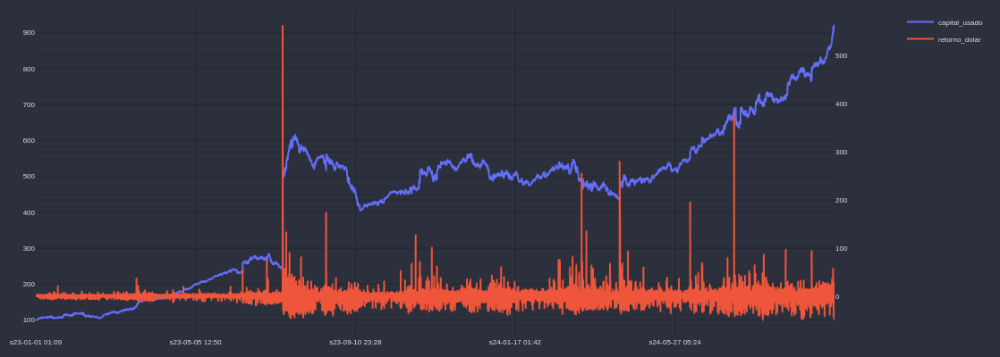

In [110]:
cp = CandlePlot(df_resultado_dinamico_alavancagem, candles=False)
cp.show_plot(line_traces = ['capital_usado'], sec_traces=['retorno_dolar'])

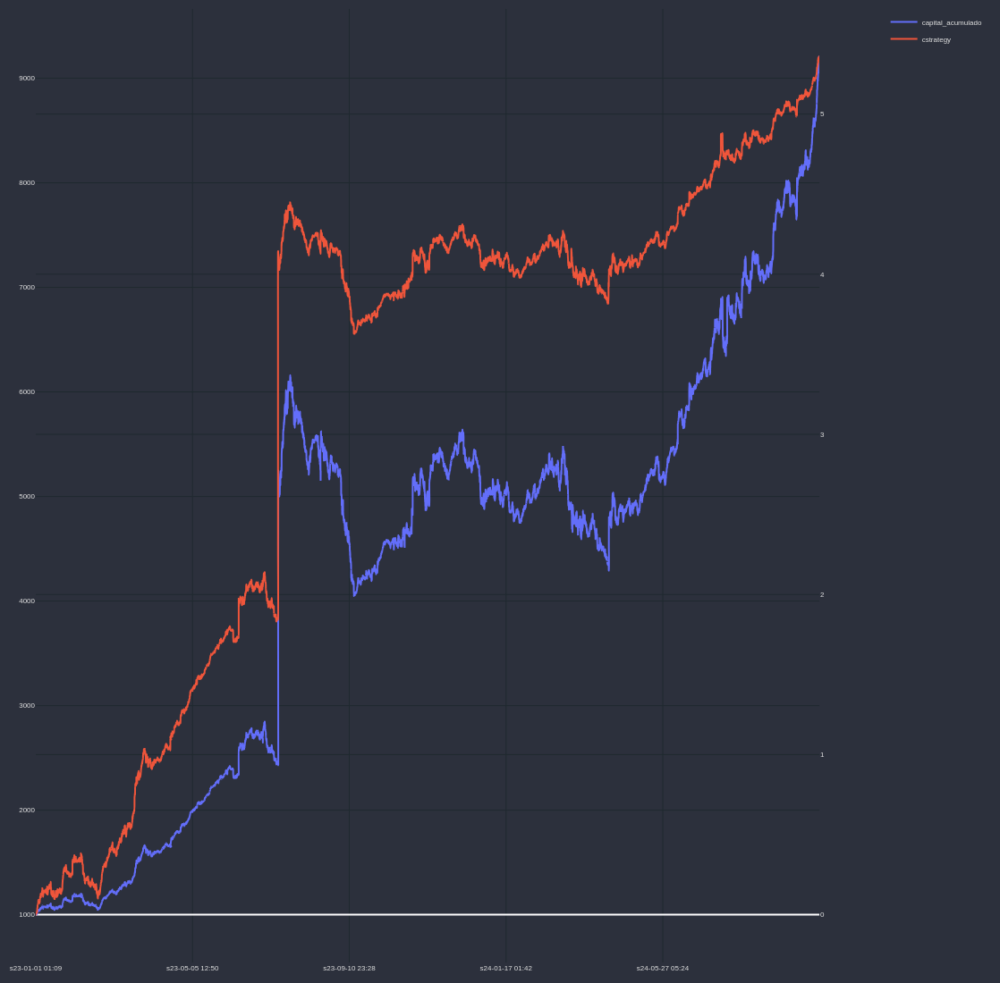

In [111]:
df_resultado_dinamico_alavancagem['cstrategy'] = df_resultado_dinamico_alavancagem.strategy_pair1.cumsum()
cp = CandlePlot(df_resultado_dinamico_alavancagem, candles=False)
cp.show_plot(line_traces = ['capital_acumulado'], sec_traces=['cstrategy'], height=1100)